# Úvod

Tento dataset si klade za cíl analyzovat veřejné preference mezi dvěma typy oblíbenými destinacemi dovolené: horami a plážemi. Poskytuje přehled o různých demografických a životních faktorech, které mohou ovlivnit tyto preference. Prozkoumáním tohoto datasetu mohou uživatelé aplikovat různé techniky strojového učení k predikci, zda jednotlivci preferují hory nebo pláže na základě jejich vlastností.

Odkaz na dataset: [Mountains vs Beaches Preferences](https://www.kaggle.com/datasets/jahnavipaliwal/mountains-vs-beaches-preference)

# Načtení knihoven

In [1]:
import time
import warnings
import pandas as pd
import matplotlib.pyplot as mplt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from imblearn.over_sampling import SMOTE
from sklearn.metrics import classification_report, f1_score, confusion_matrix, accuracy_score, precision_score, \
    recall_score
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline

# Explorační analýza dat (Exploratory Data Analysis - EDA)

## Datový slovník

| **Pojem**                  | **Popis**                                    | **Typ**                                                |
|:---------------------------|:---------------------------------------------|:-------------------------------------------------------|
| **Age**                    | Věk jednotlivce                              | Numerický                                              |
| **Gender**                 | Genderová identita jednotlivce               | Kategorický: muž, žena, nebinární                      |
| **Income**                 | Roční příjem jednotlivce                     | Numerický                                              |
| **Education Level**        | Nejvyšší dosažené vzdělání                   | Kategorický: střední škola, bakalář, magistr, doktorát |
| **Travel Frequency**       | Počet dovolených za rok                      | Numerický                                              |
| **Preferred Activities**   | Aktivity preferované během dovolené          | Kategorický: turistika, plavání, lyžování, opalování   |
| **Vacation Budget**        | Rozpočet vyhrazený na dovolené               | Numerický                                              |
| **Location**               | Typ bydliště                                 | Kategorický: městský, příměstský, venkovský            |
| **Proximity to Mountains** | Vzdálenost k nejbližším horám (v mílích)     | Numerický                                              |
| **Proximity to Beaches**   | Vzdálenost k nejbližším plážím (v mílích)    | Numerický                                              |
| **Favorite Season**        | Preferované roční období pro dovolenou       | Kategorický: léto, zima, jaro, podzim                  |
| **Pets**                   | Zda jednotlivec vlastní domácí zvířata       | Binární: 0 = Ne, 1 = Ano                               |
| **Environmental Concerns** | Zda jednotlivec má obavy o životní prostředí | Binární: 0 = Ne, 1 = Ano                               |

## Načtení dat

In [2]:
df = pd.read_csv('../datasets/projects/mountains_vs_beaches_preferences.csv')
df.head()

,Age,Gender,Income,Education_Level,Travel_Frequency,Preferred_Activities,Vacation_Budget,Location,Proximity_to_Mountains,Proximity_to_Beaches,Favorite_Season,Pets,Environmental_Concerns,Preference
0,56,male,71477,bachelor,9,skiing,2477,urban,175,267,summer,0,1,1
1,69,male,88740,master,1,swimming,4777,suburban,228,190,fall,0,1,0
2,46,female,46562,master,0,skiing,1469,urban,71,280,winter,0,0,1
3,32,non-binary,99044,high school,6,hiking,1482,rural,31,255,summer,1,0,1
4,60,female,106583,high school,5,sunbathing,516,suburban,23,151,winter,1,1,0


## Základní informace o datasetu

### Počet záznamů a atributů

In [3]:
print(f"Počet záznamů: {df.shape[0]}\nPočet atributů: {df.shape[1]}")

Počet záznamů: 52444
Počet atributů: 14


In [4]:
df.describe()

,Age,Income,Travel_Frequency,Vacation_Budget,Proximity_to_Mountains,Proximity_to_Beaches,Pets,Environmental_Concerns,Preference
count,52444.000000,52444.000000,52444.000000,52444.000000,52444.000000,52444.000000,52444.000000,52444.000000,52444.000000
mean,43.507360,70017.271280,4.489265,2741.799062,149.943502,149.888452,0.500858,0.498436,0.250706
std,14.985597,28847.560428,2.876130,1296.922423,86.548644,86.469248,0.500004,0.500002,0.433423
min,18.000000,20001.000000,0.000000,500.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,31.000000,45048.250000,2.000000,1622.000000,75.000000,75.750000,0.000000,0.000000,0.000000
50%,43.000000,70167.000000,4.000000,2733.000000,150.000000,150.000000,1.000000,0.000000,0.000000
75%,56.000000,95108.500000,7.000000,3869.000000,225.000000,225.000000,1.000000,1.000000,1.000000
max,69.000000,119999.000000,9.000000,4999.000000,299.000000,299.000000,1.000000,1.000000,1.000000


Lze vidět, že *průměrný věk* je **43,5** roku, *medián příjmu* je **70 167** jednotek a *většina uživatelů* podniká **4 dovolené ročně**. Hodnoty sloupců jako *Pets* nebo *Environmental_Concerns* jsou binární, zatímco atributy jako *Vacation_Budget* ukazují **vyšší rozptyl**. Mnoho dalších atributů je kategorických a bude třeba provést další analýzy.

### Datové typy atributů

In [5]:
df.dtypes

Age                        int64
Gender                    object
Income                     int64
Education_Level           object
Travel_Frequency           int64
Preferred_Activities      object
Vacation_Budget            int64
Location                  object
Proximity_to_Mountains     int64
Proximity_to_Beaches       int64
Favorite_Season           object
Pets                       int64
Environmental_Concerns     int64
Preference                 int64
dtype: object

#### Numerické atributy

In [6]:
numerical_columns = df.select_dtypes(include='int64').columns
print("\n".join(numerical_columns))

Age
Income
Travel_Frequency
Vacation_Budget
Proximity_to_Mountains
Proximity_to_Beaches
Pets
Environmental_Concerns
Preference


S numeryckými atributy můžeme provést následující analýzy:
- Rozdělení hodnot
- Korelace mezi atributy
- Distribuce hodnot
- Normalizace hodnot
- Transformace hodnot

#### Kategorické atributy

In [7]:
categorical_columns = df.select_dtypes(include=['object']).columns
for column in categorical_columns:
    print(f"{column}: {df[column].unique()}")

Gender: ['male' 'female' 'non-binary']
Education_Level: ['bachelor' 'master' 'high school' 'doctorate']
Preferred_Activities: ['skiing' 'swimming' 'hiking' 'sunbathing']
Location: ['urban' 'suburban' 'rural']
Favorite_Season: ['summer' 'fall' 'winter' 'spring']


V kategorických atributech nemáme žádné zbytečné hodnoty, které by bylo třeba odstranit. Každý z nich má svůj význam a předpokládame, že budou důležité pro analýzu. Další zpracování bude zahrnuto v dalších krocích.

### Chybějící hodnoty

In [8]:
missing_values = int(df.isnull().sum().sum())
missing_values

0

Paráda, v datasetu nejsou žádné chybějící hodnoty.

### Duplicitní záznamy

In [9]:
duplicates = int(df.duplicated().astype(int).sum())
duplicates

0

Skvělé, v datasetu nejsou ani žádné duplicitní záznamy.

### Visualizace dat

 #### Distribuce kategorických atributů

In [10]:
def plot_summary_categorical(_df, _column):
    print(pd.DataFrame({"Počet záznamů": _df[_column].value_counts(),
                        "Podíl záznamů (%)": _df[_column].value_counts(normalize=True) * 100}))

    values = _df[_column].value_counts()
    colors = sns.color_palette("viridis", len(values))

    mplt.figure(figsize=(14, 7))

    mplt.subplot(1, 2, 1)
    sns.countplot(data=_df, x=_df[_column], hue=_df[_column], palette=colors, legend=False)
    mplt.title(f"Počet záznamů pro kategorický atribut: {_column}")
    mplt.xticks(rotation=45)

    mplt.subplot(1, 2, 2)
    mplt.pie(x=values, labels=values.index, autopct="%.1f%%", startangle=90, colors=colors)
    mplt.title(f"Podíl záznamů pro kategorický atribut: {_column}")

    mplt.legend()
    mplt.show()

            Počet záznamů  Podíl záznamů (%)
Gender                                      
female              17638          33.632065
male                17522          33.410876
non-binary          17284          32.957059


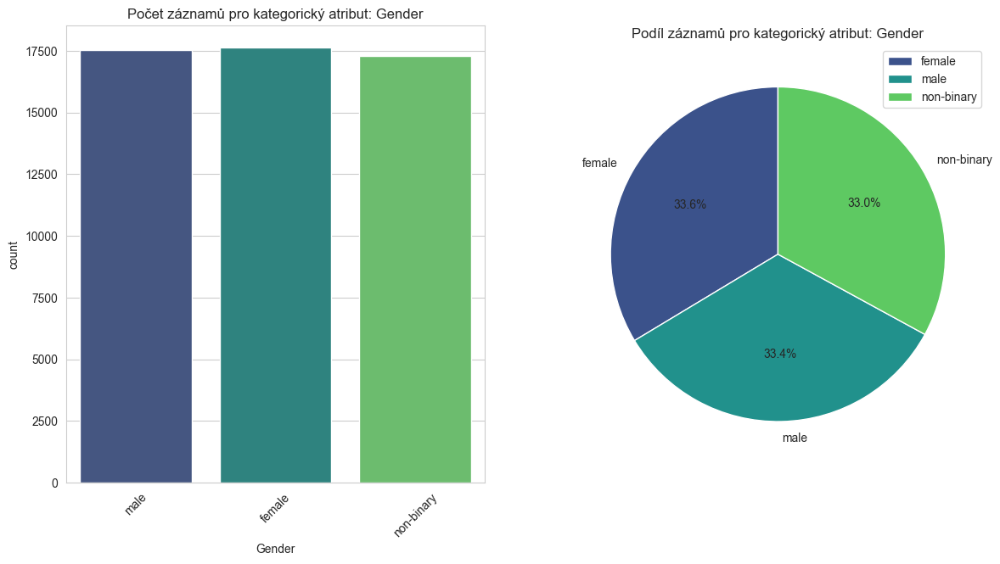

                 Počet záznamů  Podíl záznamů (%)
Education_Level                                  
doctorate                13293          25.347037
bachelor                 13127          25.030509
high school              13072          24.925635
master                   12952          24.696819


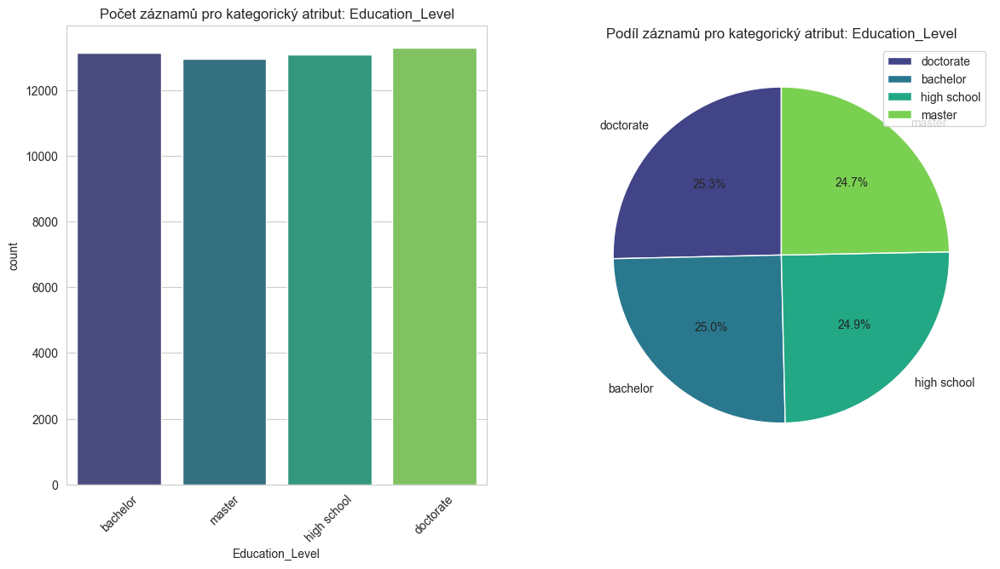

                      Počet záznamů  Podíl záznamů (%)
Preferred_Activities                                  
sunbathing                    13221          25.209748
skiing                        13167          25.106781
hiking                        13102          24.982839
swimming                      12954          24.700633


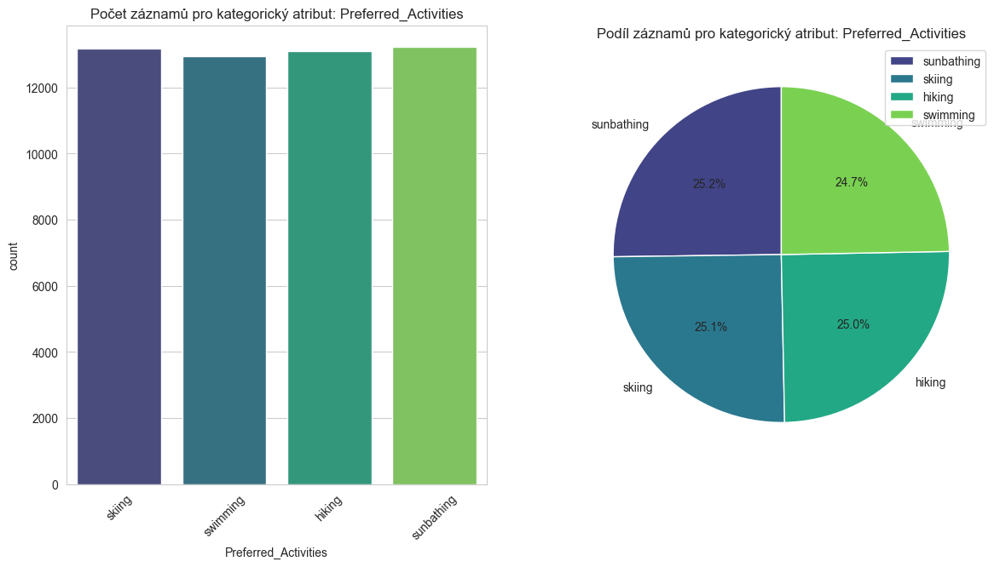

          Počet záznamů  Podíl záznamů (%)
Location                                  
suburban          17503          33.374647
urban             17476          33.323164
rural             17465          33.302189


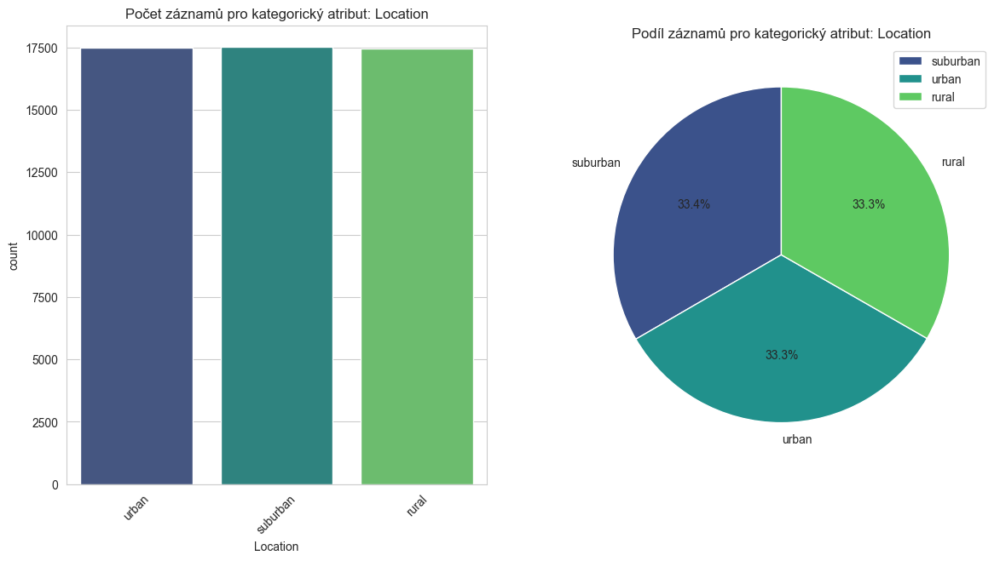

                 Počet záznamů  Podíl záznamů (%)
Favorite_Season                                  
summer                   13303          25.366105
fall                     13170          25.112501
winter                   13019          24.824575
spring                   12952          24.696819


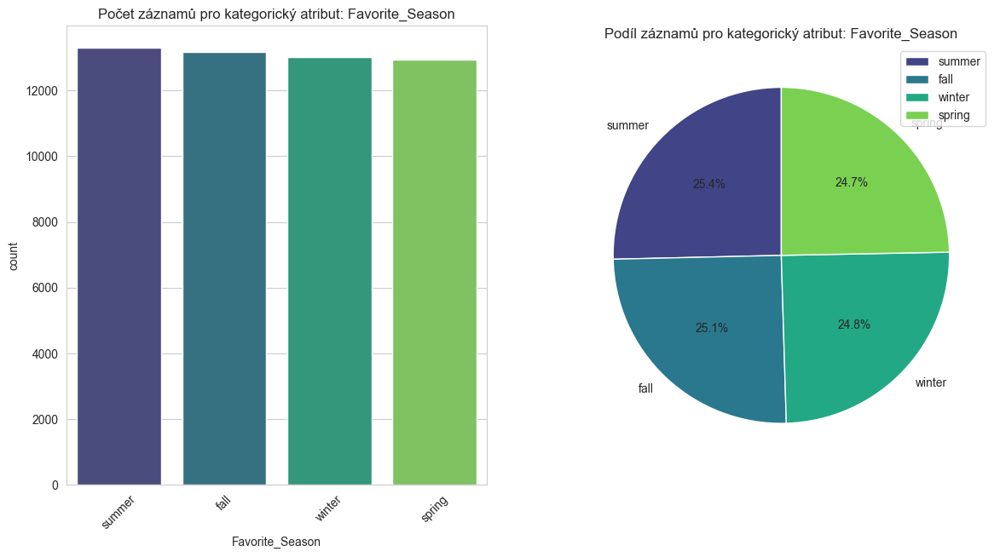

In [11]:
for column in categorical_columns:
    plot_summary_categorical(df, column)

Vidíme, že všechny kategorické atributy mají skoro perfektní rozdělení hodnot.

#### Distribuce v binárních atributech

In [12]:
binary_columns = df[['Pets', 'Environmental_Concerns', 'Preference']]

In [13]:
def plot_summary_binary(_df, _column):
    values = _df[_column].value_counts()
    colors = sns.color_palette("viridis", len(values))

    mplt.figure(figsize=(14, 7))

    mplt.subplot(1, 2, 1)
    sns.countplot(data=_df, x=_df[_column], hue=_df[_column], palette=colors, legend=False)
    mplt.title(f"Počet záznamů pro binární atribut: {_column}")

    mplt.subplot(1, 2, 2)
    mplt.pie(x=values, labels=values.index, autopct="%.1f%%", startangle=90, colors=colors)
    mplt.title(f"Podíl záznamů pro binární atribut: {_column}")

    mplt.legend()
    mplt.show()

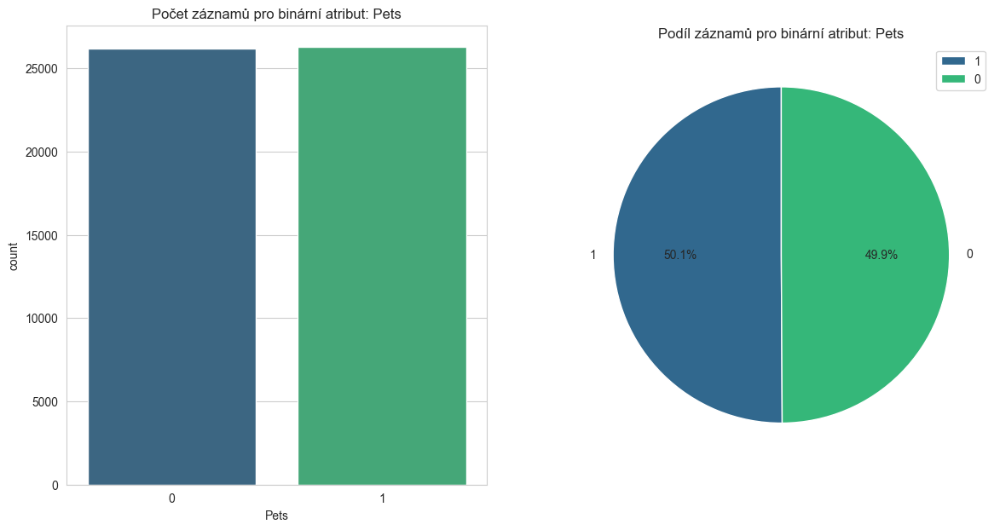

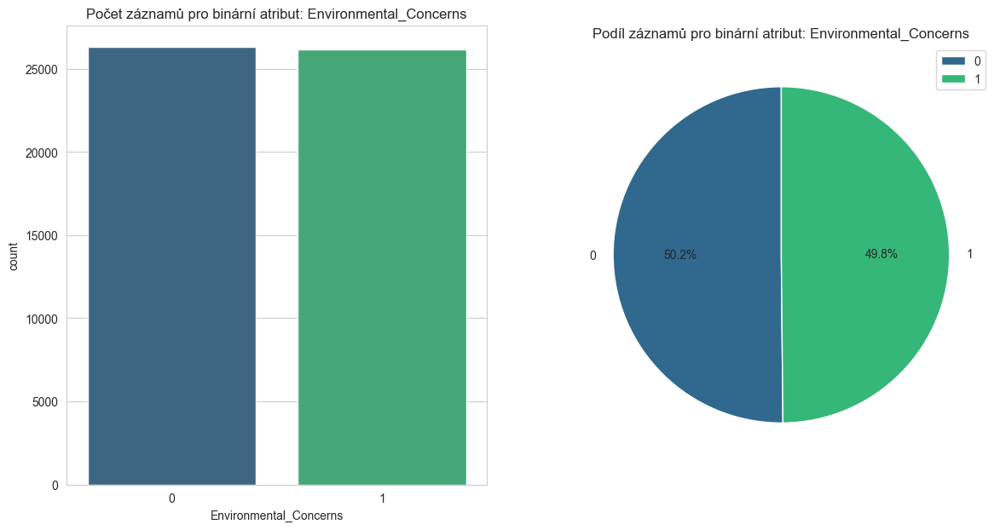

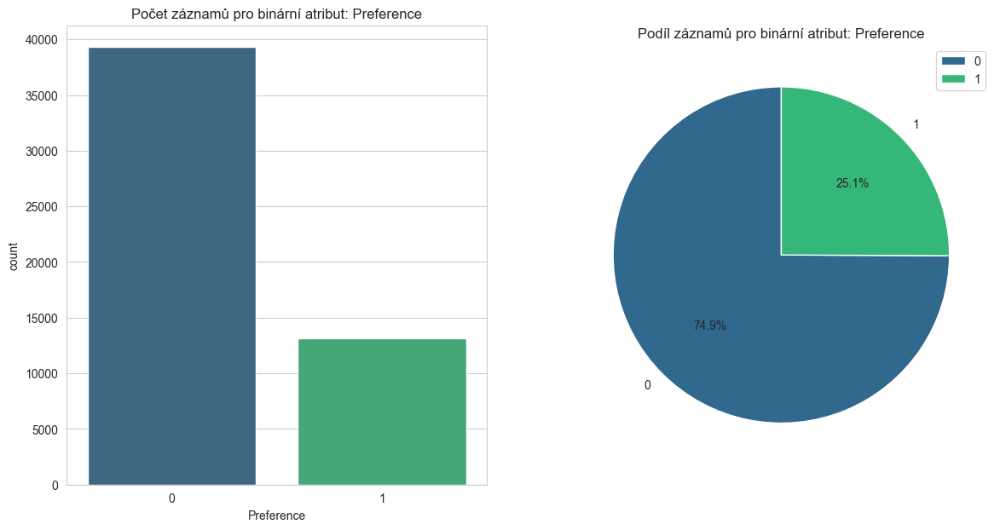

In [14]:
for column in binary_columns:
    plot_summary_binary(df, column)

Vidíme, že všechny binární atributy mají také skoro perfektní rozdělení hodnot, až na atribut *Preference*, který bude důležitý pro klasifikaci. Pro zatím zůstaneme u těchto analýz a přejdeme k dalším krokům.

#### Distribuce numerických atributů

Nyní se podíváme na distribuci hodnot pro numerické atributy bez binárních atributů, které jsme již zpracovali.

In [15]:
numerical_columns = df.select_dtypes(include='int64').columns.difference(binary_columns.columns)

In [16]:
def plot_summary_numerical(_df, _column):
    mplt.figure(figsize=(14, 7))

    mean = _df[_column].mean()
    median = _df[_column].median()

    mplt.subplot(1, 2, 1)
    sns.histplot(data=_df, x=_column, kde=True)
    mplt.title(f"Distribuce hodnot pro numerický atribut: {_column}")
    # put the median and mean values on the plot and show the legend on the left
    mplt.axvline(mean, color='r', linestyle='--', label=f"Průměr: {mean:.2f}")
    mplt.axvline(median, color='g', linestyle='--', label=f"Medián: {median:.2f}")
    mplt.legend(loc='upper left')

    mplt.subplot(1, 2, 2)
    sns.boxplot(data=_df, x=_column)
    mplt.title(f"Boxplot pro numerický atribut: {_column}")

    mplt.show()

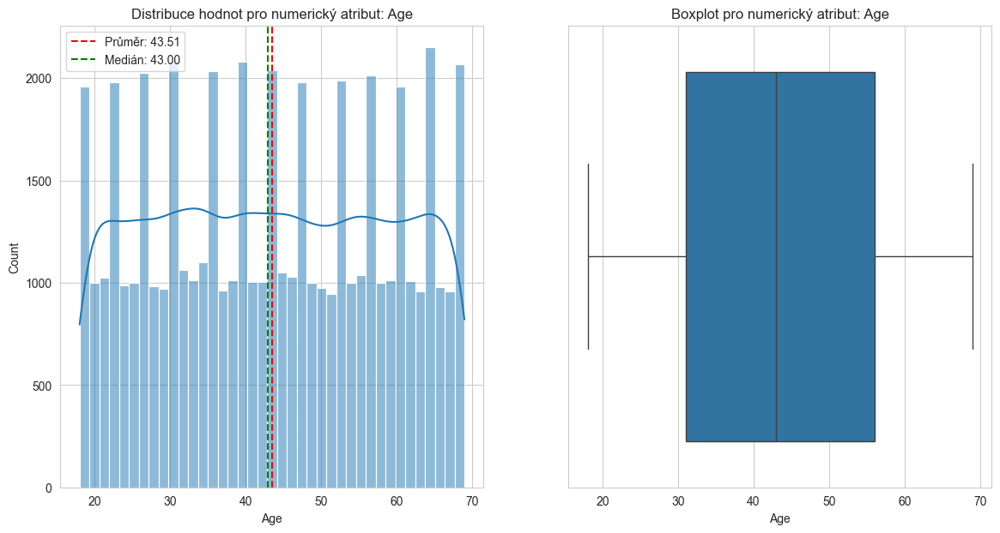

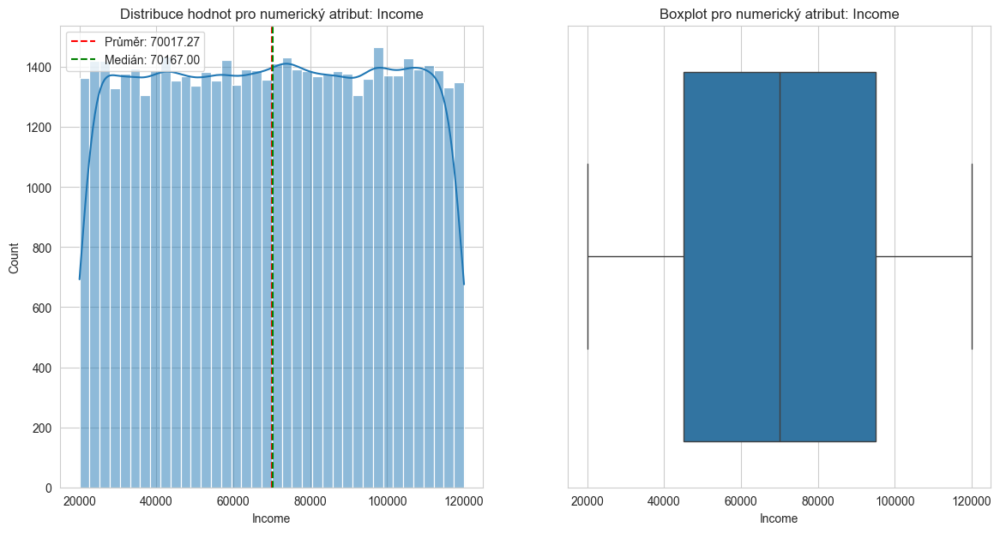

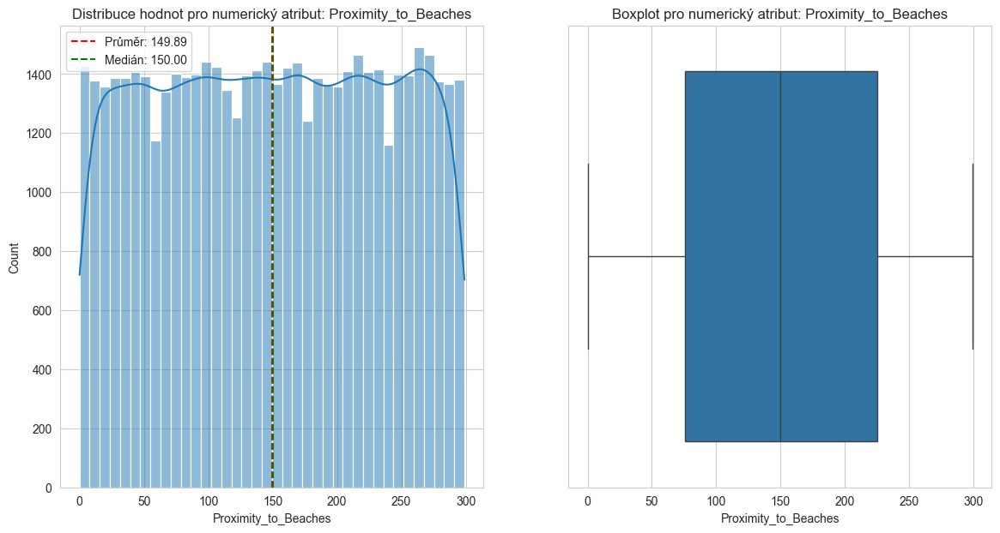

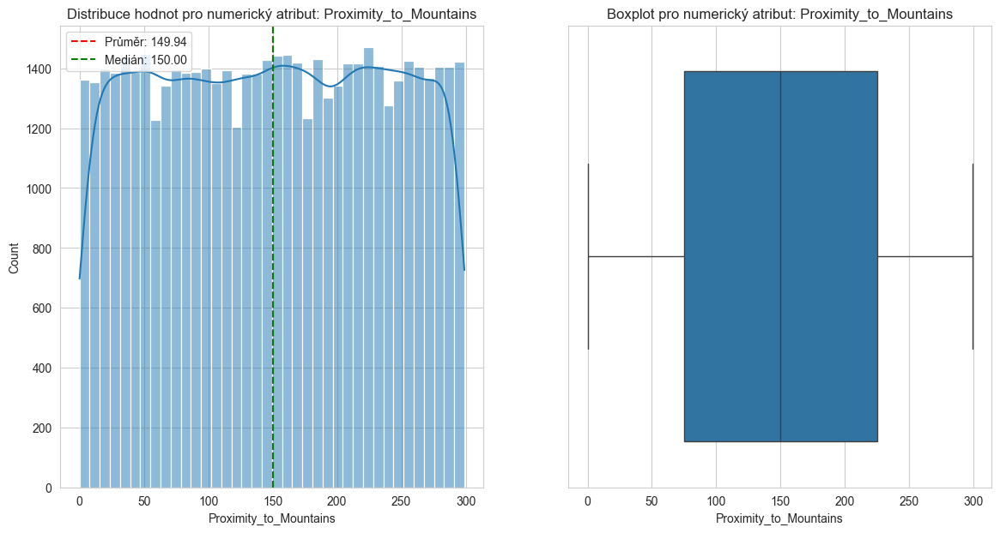

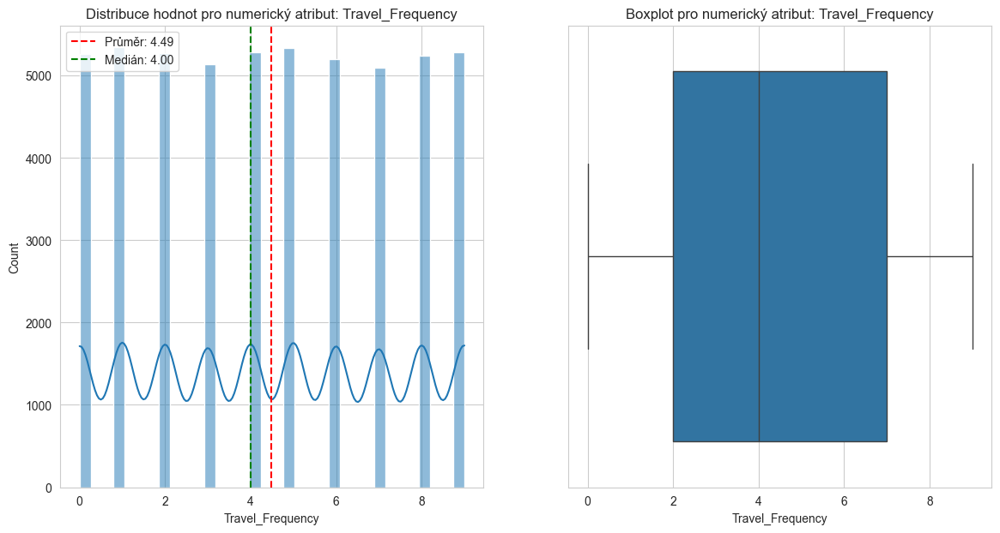

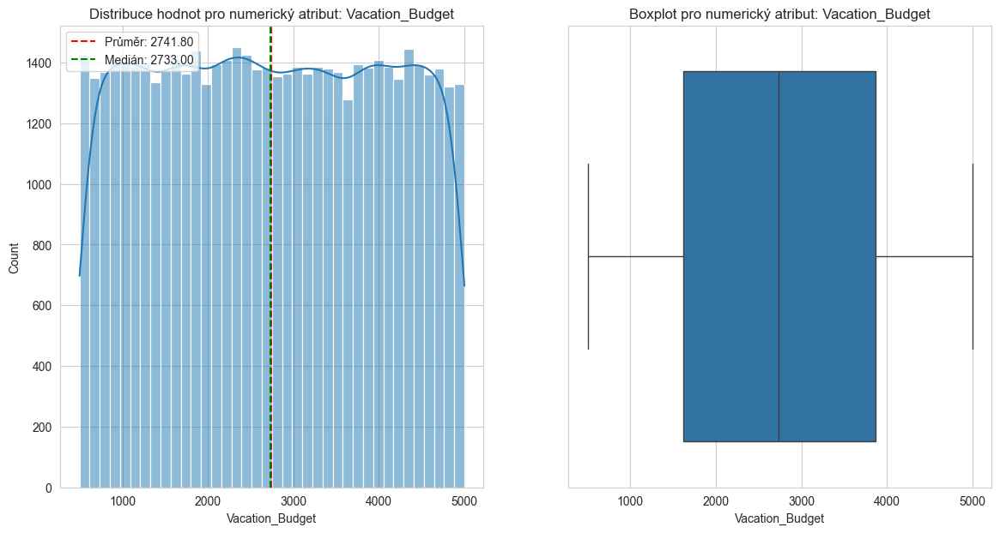

In [17]:
for column in numerical_columns:
    plot_summary_numerical(df, column)

Opět jsou všechny numerické atributy v datasetu rozděleny dobře. Nyní se podíváme na vztah cílového atributu s ostatními atributy a na korelaci mezi numerickými atributy.

#### Vztah cílového atributu s ostatními atributy

In [18]:
for col in df.columns:
    fig = px.histogram(df, x=col, color="Preference", title=col + ' vs Preference')
    fig.show()

Tady se potvrzuje stejný trend, který jsme viděli u distribuce pro všechny atributy. Všechny atributy mají dobré rozdělení hodnot a nejsou žádné výrazné odchylky. Ovšem pláže jsou v převaze 3:1 oproti horám. Uvidíme, jestli zde bude potřeba nějakého vyvážení tříd. Prozatím se podíváme na korelaci mezi numerickými atributy.

#### Korelace mezi numerickými atributy

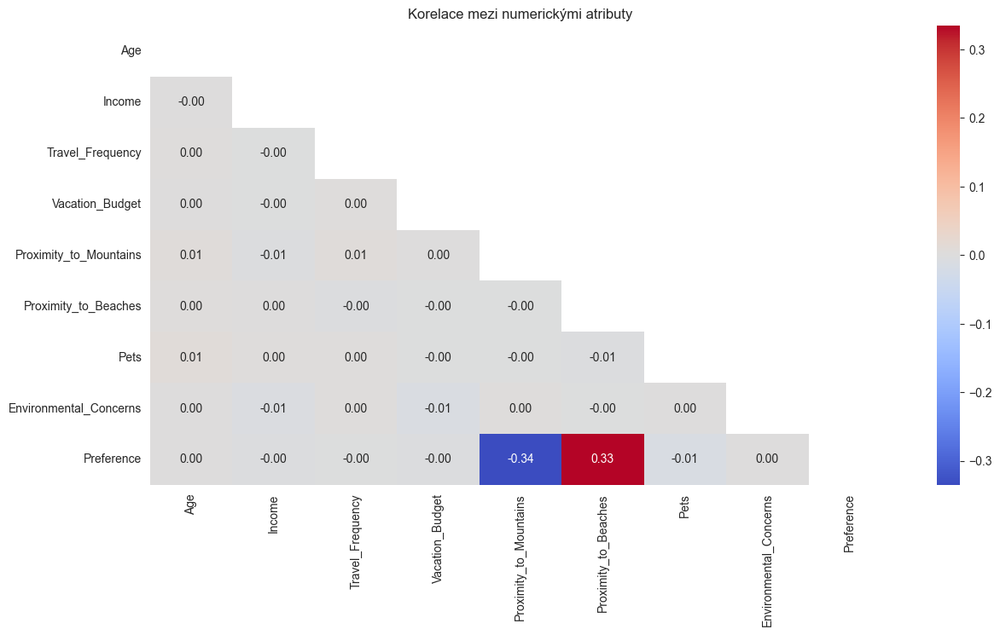

In [19]:
corr = df.corr(numeric_only=True)
mask = np.triu(corr)

mplt.figure(figsize=(14, 7))
sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm', mask=mask)
mplt.title("Korelace mezi numerickými atributy")
mplt.grid(False)
mplt.show()

Z heatmapy korelace můžeme vidět, že atributy *Proximity_to_Mountains* a *Proximity_to_Beaches* mají nejvyšší korelaci, což je očekávané. Jinak nejsou žádné významné korelace mezi atributy.

Jelikož máme jen 13 atributů, tak se nebudeme snažit o žádné odstranění atributů, nebo *feature engineering*. V dalších krocích se budeme věnovat předzpracování dat a klasifikaci.

## Předzpracování dat

### Kódování kategorických atributů

Pojdme zakódovat kategorické atributy, abychom je mohli použít v klasifikaci. Nejprve si zobrazíme unikátní hodnoty pro každý kategorický atribut.

In [20]:
for column in categorical_columns:
    print(f"{column}: {df[column].unique()}")

Gender: ['male' 'female' 'non-binary']
Education_Level: ['bachelor' 'master' 'high school' 'doctorate']
Preferred_Activities: ['skiing' 'swimming' 'hiking' 'sunbathing']
Location: ['urban' 'suburban' 'rural']
Favorite_Season: ['summer' 'fall' 'winter' 'spring']


U kódování kategorických atributů se používá buď:
- One-hot encoding
- Label encoding
- Ordinal encoding

Výsledkem **One-hot encoding** je vytvoření nových sloupců pro každou unikátní hodnotu v kategorickém atributu. V každém sloupci je zaznamenáno binární označení, kde 1 znamená přítomnost dané hodnoty a 0 její nepřítomnost. Její výhodou je, že nezavádí žádné pořadí mezi hodnotami. Největší nevýhodou je, že může způsobit problémy s velkým množstvím unikátních hodnot. Vhodný pro rozhodovací stromy.

Výsledkem **Label encoding** je přiřazení číselné hodnoty každé unikátní hodnotě v kategorickém atributu. Hodnoty jsou reprezentovány jako celé číslo bez ohledu na pořadí. Jeho výhodou je, že je jednoduchý a efektivní, ale může způsobit problémy s interpretací výsledků. Vhodný pro lineární a logistickou regresi.

Výsledkem **Ordinal encoding** je přiřazení číselné hodnoty každé unikátní hodnotě v kategorickém atributu, přičemž tato čísla odrážejí pořadí hodnot, pokud kategorie mají logickou posloupnost.

Jediný atribut, u které se dá použít **Ordinal encoding** je *Education_Level*, protože má logickou posloupnost hodnot. U ostatních atributů použijeme **One-hot encoding**.

In [21]:
df_encoded = df.copy()

#### Ordinal encoding

In [22]:
education_level_mapping = {
    'high school': 1,
    'bachelor': 2,
    'master': 3,
    'doctorate': 4
}

df_encoded['Education_Level'] = df_encoded['Education_Level'].map(education_level_mapping)

#### One-hot encoding

In [23]:
df_encoded = pd.get_dummies(df_encoded)

In [24]:
df_encoded.head()

,Age,Income,Education_Level,Travel_Frequency,Vacation_Budget,Proximity_to_Mountains,Proximity_to_Beaches,Pets,Environmental_Concerns,Preference,...,Preferred_Activities_skiing,Preferred_Activities_sunbathing,Preferred_Activities_swimming,Location_rural,Location_suburban,Location_urban,Favorite_Season_fall,Favorite_Season_spring,Favorite_Season_summer,Favorite_Season_winter
0,56,71477,2,9,2477,175,267,0,1,1,...,True,False,False,False,False,True,False,False,True,False
1,69,88740,3,1,4777,228,190,0,1,0,...,False,False,True,False,True,False,True,False,False,False
2,46,46562,3,0,1469,71,280,0,0,1,...,True,False,False,False,False,True,False,False,False,True
3,32,99044,1,6,1482,31,255,1,0,1,...,False,False,False,True,False,False,False,False,True,False
4,60,106583,1,5,516,23,151,1,1,0,...,False,True,False,False,True,False,False,False,False,True


### Normalizace a škálování dat

Normálně se provádí škálování dat, protože mnoho algoritmů strojového učení vyžaduje, aby všechny atributy byly ve stejném měřítku. Jelikož náš dataset je dosti vybalancovaný a nemáme žádné výrazné odlehlé hodnoty, bude těžké určit, který scaler bude nejlepší. Proto zkusíme všechny tři základní scalery a porovnáme jejich výsledky.

In [25]:
def perform_scaling(_df, _column):
    scalers = {
        'Original': _df[_column],
        'MinMaxScaler': MinMaxScaler(),
        'StandardScaler': StandardScaler(),
        'RobustScaler': RobustScaler()
    }

    scaled_data = {}
    for scaler_name, scaler in scalers.items():
        if scaler_name == 'Original':
            scaled_data[scaler_name] = _df[_column]
        else:
            scaled_data[scaler_name] = scaler.fit_transform(
                _df[_column].values.reshape(-1, 1)).flatten()

    mplt.figure(figsize=(14, 7))
    for index, (scaler_name, data) in enumerate(scaled_data.items()):
        mplt.subplot(2, 2, index + 1)
        sns.kdeplot(data, label=scaler_name)
        mplt.title(f"Distribuce hodnot pro škálování: {scaler_name}")
        mplt.legend()

    print(f"Škálování atributu: {_column}")
    for scaler_name, data in scaled_data.items():
        print(f"{scaler_name}: Min = {data.min()}, Max = {data.max()}, "
              f"Mean = {data.mean():.2f}, Std = {data.std():.2f}")

    mplt.tight_layout()
    mplt.show()

Škálování atributu: Age
Original: Min = 18, Max = 69, Mean = 43.51, Std = 14.99
MinMaxScaler: Min = 0.0, Max = 1.0, Mean = 0.50, Std = 0.29
StandardScaler: Min = -1.7021412637157018, Max = 1.7011589469054649, Mean = 0.00, Std = 1.00
RobustScaler: Min = -1.0, Max = 1.04, Mean = 0.02, Std = 0.60


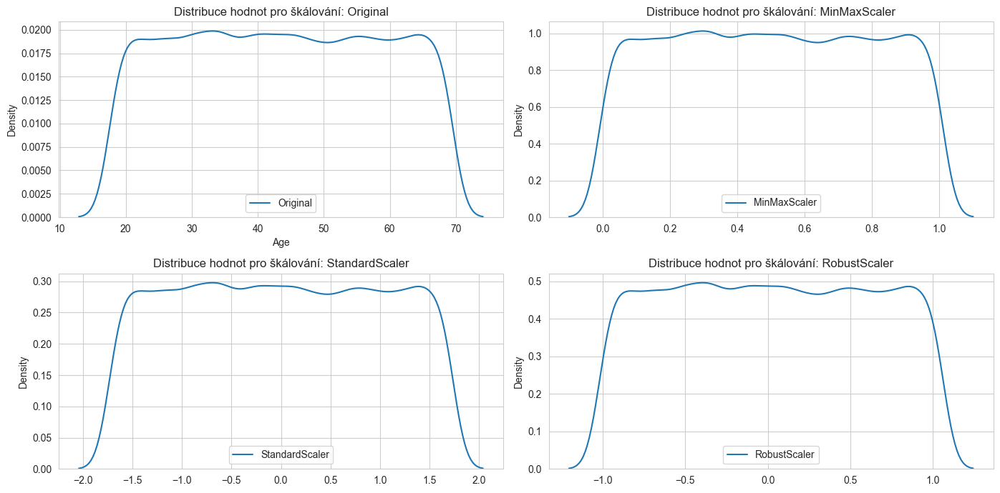

In [26]:
perform_scaling(df_encoded, 'Age')

Pro rozhodovací stromy škálování **není potřeba**, protože tyto modely jsou necitlivé na měřítko. Rozhodovací stromy provádějí dělení dat na základě hodnot atributů, nikoliv jejich vzdáleností, takže škálování nemá žádný vliv na jejich výkon. Použití škálovaných dat může dokonce poškodit výsledky, protože škálování pouze převádí hodnoty na interval <0, 1>, aniž by to zlepšilo jejich schopnost dělení. Vizualizace ukazuje, že škálovaná data se příliš neliší od původních, což může negativně ovlivnit interpretaci a výkon modelu.

Vidíme, že rozdělení cílového atributu je stejné pro trénovací a testovací množinu. V dalším kroku se budeme věnovat klasifikaci.

# Klasifikace

V rámci projektu si máme vyzkoušet `DecisionTree` a `RandomForest` klasifikátory. Pro každý z nich provedeme trénování, predikci a vyhodnocení výsledků.

## Počítání času

Pro měření času trénování a predikce modelů můžeme vytvořit vlastní třídu, která bude měřit čas mezi vstupem a výstupem. Jen tak pro zajímavost.

In [27]:
class TimeTracker:
    def __enter__(self):
        self.start_time = time.time()
        return self

    def __exit__(self, exc_type, exc_value, traceback):
        self.end_time = time.time()
        self.execution_time = self.end_time - self.start_time
        minutes = self.execution_time // 60
        seconds = self.execution_time % 60
        print(f"Celkový čas: {minutes:.0f} minut a {seconds:.2f} sekund")

## Zvolená metrika

Pro vyhodnocení výsledků klasifikace použijeme následující metriky:
- **Accuracy**: Míra, jak dobře model klasifikuje správně všechny třídy.
- **Precision**: Míra, jak dobře model klasifikuje pozitivní třídy.
- **Recall**: Míra, jak dobře model klasifikuje všechny pozitivní třídy.
- **F1-score**: Harmonický průměr precision a recall. 

Dobrou metrikou může být **přesnost**. U té nás zajímá, kolik predikcí je celkově správně. *Precision* a *Recall* nám tolik neříkají, protože nás nezajímá, kolikrát jsme určili správně, že někdo preferuje hory, ale kolikrát jsme určili, že někdo preferuje hory a bylo to správně. Ale jelikož nemáme vyvážený dataset, tak se může hodit *F1-score*, který bere v potaz poměr mezi *Precision* a *Recall*.

## Rozdělení dat na trénovací a testovací data

Nejprve si rozdělíme data na trénovací a testovací množinu v poměru **80:20**. 80 % dat použijeme pro trénování modelu a 20 % pro testování. Často se používá tento poměr, ale můžeme vidět i jiné poměry, jako 70:30 nebo 90:10. Také vynecháme validaci, protože použijeme GridSearchCV pro hledání nejlepších parametrů pro model.

Taky můžeme vytvářet nové trénovací data pomocí **K-Fold Cross Validation**. Tato metoda rozdělí data na K částí a trénuje model K-krát, kde každá část je použita jako testovací data jednou a zbylé části jsou použity jako trénovací data. Ale jelikož nemáme data rovnovážná, tuto metodu nebudeme používat. Alternativou může být **Strafied K-Fold Cross Validation**, která zajišťuje, že každá část má stejný poměr tříd jako celý dataset. Prozatím se spokojíme s trénovací a testovací množinou.

### Oddělení cílového atributu a atributů pro trénování

In [28]:
X = df_encoded.drop(columns=['Preference'])
y = df_encoded['Preference']

#### Rozdělení dat na trénovací a testovací množinu

In [29]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [30]:
X_train.shape, X_test.shape

((41955, 23), (10489, 23))

### Vyvážení tříd

In [31]:
y_train.value_counts(normalize=True), y_test.value_counts(normalize=True)

(Preference
 0    0.749494
 1    0.250506
 Name: proportion, dtype: float64,
 Preference
 0    0.748498
 1    0.251502
 Name: proportion, dtype: float64)

Vidíme, že máme nevyvážený dataset, kde je větší počet tříd *Beaches* oproti *Mountains*. V dalším kroku zkusíme vyvážit třídy pomocí **SMOTE**.

## SMOTE 

SMOTE (Synthetic Minority Over-sampling Technique) je technika pro vyvážení tříd, která vytváří syntetické vzorky tříd, které jsou podzastoupeny. Tímto způsobem můžeme dosáhnout vyváženého datasetu a zlepšit výsledky klasifikace.

In [32]:
smote = SMOTE(random_state=42)

In [33]:
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

In [34]:
y_train_resampled.value_counts(normalize=True)

Preference
0    0.5
1    0.5
Name: proportion, dtype: float64

Nyní máme vyvážený dataset, ale s větším počtem záznamů, kde čtvrtina by měla být umělá data. V dalším kroku se podíváme na klasifikaci s nevyváženými a vyváženými daty.

## DecisionTree klasifikátor

Rozhodovací strom je jedním z nejjednodušších algoritmů strojového učení, který je schopen provádět klasifikaci. 

### DecisionTree klasifikátor bez vyvážení tříd

In [35]:
dt = DecisionTreeClassifier(random_state=42)

In [36]:
dt.fit(X_train, y_train)

DecisionTreeClassifier(random_state=42)

In [37]:
y_pred_dt = dt.predict(X_test)

In [38]:
print(classification_report(y_test, y_pred_dt))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7851
           1       0.99      0.99      0.99      2638

    accuracy                           0.99     10489
   macro avg       0.99      0.99      0.99     10489
weighted avg       0.99      0.99      0.99     10489



In [39]:
print(f"F1-score: {f1_score(y_test, y_pred_dt)}")

F1-score: 0.9884622659353131


Na základě výsledků můžeme vidět, že model dosáhl **F1-skóre 0,9884**, což je velmi dobrý výsledek. Všechny třídy byly predikovány správně. Podívejme se na **confusion matrix**, abychom zjistili, zda model se nanaučil predikovat pouze největší třídu.

#### Confusion matrix pro DecisionTree s nevyváženými třídami

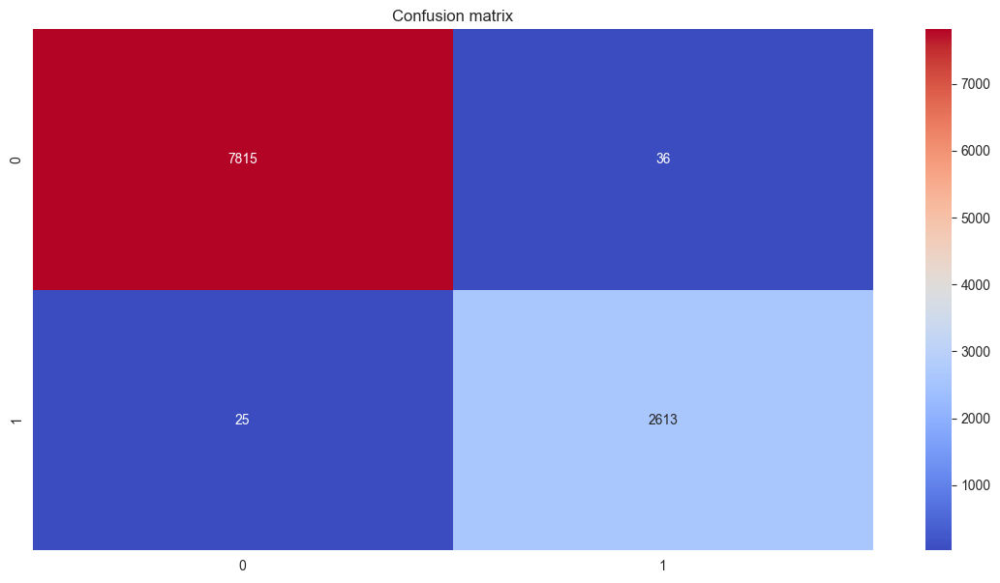

In [40]:
mplt.figure(figsize=(14, 7))
mplt.title("Confusion matrix")
sns.heatmap(confusion_matrix(y_test, y_pred_dt), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

Paráda, model predikoval většinu tříd správně. Než se podíváme na Random Forest, zkusíme ještě zjistit, které atributy byly nejdůležitější pro predikci. Jen tak pro zajímavost.

#### Důležitost atributů pro DecisionTree

In [41]:
feature_importances = pd.DataFrame({'Feature': X.columns, 'Importance': dt.feature_importances_})
feature_importances = feature_importances.sort_values(by='Importance', ascending=False)

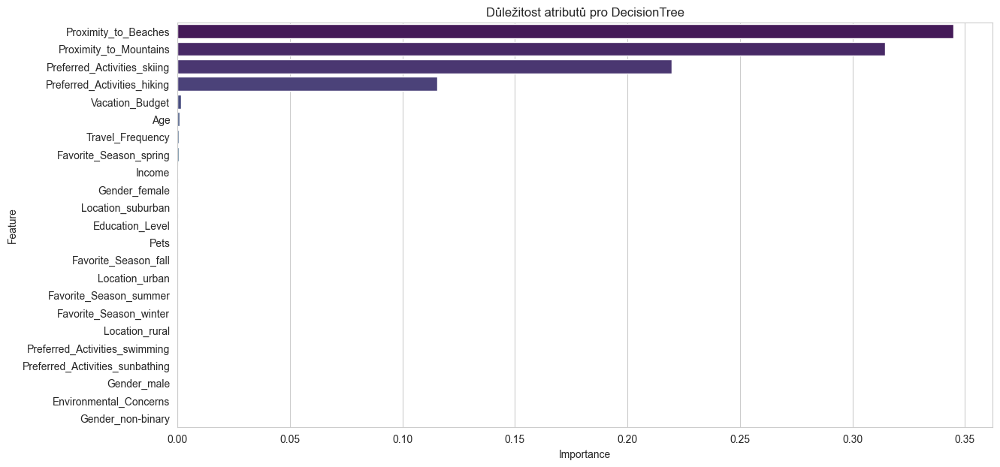

In [42]:
mplt.figure(figsize=(14, 7))
sns.barplot(data=feature_importances, x='Importance', y='Feature', palette='viridis', hue='Feature')
mplt.title("Důležitost atributů pro DecisionTree")
mplt.show()

Z grafu vidíme, že nejdůležitější atributy pro predikci byly *Proximity_to_Beaches* a *Proximity_to_Mountains*, což je očekávané, protože jsou nejvíce korelované již z explorativní analýzy. Dále jsou důležité atributy *Preferred_Activities_skiing* a *Preferred_Activities_hiking*, což silně souvisí s preferencí hor nebo pláží. Drobnější významnost mají atributy *Vacation_BUdge*, *Age*, *Travel_Frequency* a *Favorite_Season_spring*, což jasně ukazuje prospěch k oběma třídám.

### DecisionTree s vyváženými třídami

In [43]:
dt_resampled = DecisionTreeClassifier(random_state=42)

In [44]:
dt_resampled.fit(X_train_resampled, y_train_resampled)

DecisionTreeClassifier(random_state=42)

In [45]:
y_pred_dt_resampled = dt_resampled.predict(X_test)

In [46]:
print(classification_report(y_test, y_pred_dt_resampled))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7851
           1       0.99      0.99      0.99      2638

    accuracy                           1.00     10489
   macro avg       1.00      1.00      1.00     10489
weighted avg       1.00      1.00      1.00     10489



In [47]:
print(f"F1-score: {f1_score(y_test, y_pred_dt_resampled)}")

F1-score: 0.9937511834879758


Výsledek je téměř stejný jako u modelu bez vyvážení tříd, akorát o jednu tisícinu lepší. Podívejme se na **confusion matrix**, jestli se něco změnilo.

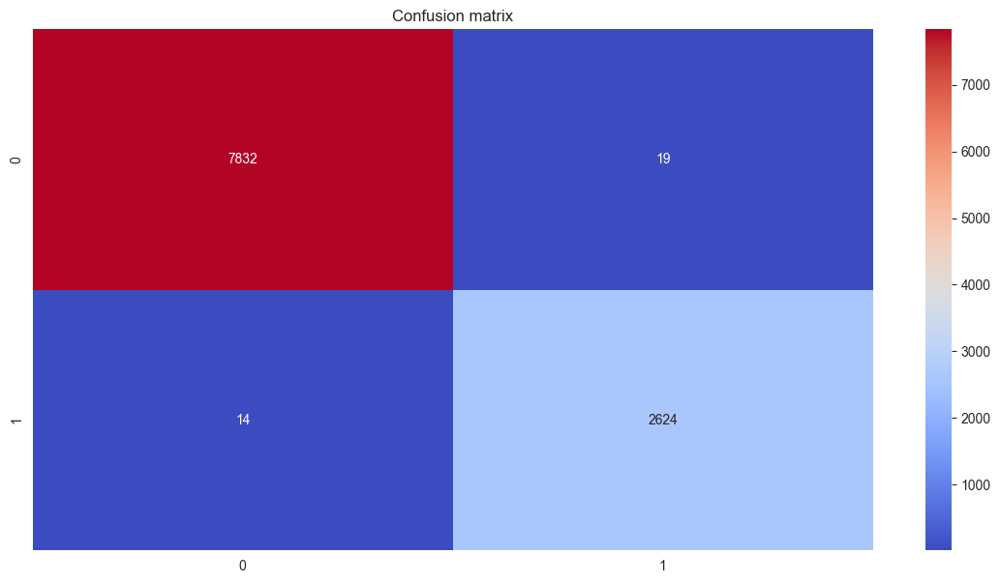

In [48]:
mplt.figure(figsize=(14, 7))
mplt.title("Confusion matrix")
sns.heatmap(confusion_matrix(y_test, y_pred_dt_resampled), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

Výsledek se trochu zlepšil, ale nebyl to žádný zásadní rozdíl. Nyní se podívat na rozdíly mezi oběma modely.

#### Rozdíly mezi DecisionTree bez a s vyvážením tříd

In [49]:
no_smote_dt_results = {
    'accuracy': accuracy_score(y_test, y_pred_dt),
    'precision': precision_score(y_test, y_pred_dt),
    'recall': recall_score(y_test, y_pred_dt),
    'f1': f1_score(y_test, y_pred_dt)
}

smote_dt_results = {
    'accuracy': accuracy_score(y_test, y_pred_dt_resampled),
    'precision': precision_score(y_test, y_pred_dt_resampled),
    'recall': recall_score(y_test, y_pred_dt_resampled),
    'f1': f1_score(y_test, y_pred_dt_resampled)
}

In [50]:
for key in no_smote_dt_results.keys():
    print(f"{key}: {smote_dt_results[key]} - {no_smote_dt_results[key]} = "
          f"{smote_dt_results[key] - no_smote_dt_results[key]}")

accuracy: 0.9968538468872151 - 0.9941843836400038 = 0.00266946324721129
precision: 0.9928111993946274 - 0.986409966024915 = 0.0064012333697123225
recall: 0.9946929492039424 - 0.9905231235784685 = 0.004169825625473855
f1: 0.9937511834879758 - 0.9884622659353131 = 0.0052889175526626975


Rozdíl je opravdu zanedbatelný, ale pro další bádání se může hodit. Nyní zkusíme najít nejlepší parametry pro DecisionTree pomocí GridSearchCV.

### GridSearchCV

In [51]:
param_grid_dt = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': [None, 5, 10, 15, 20, 30, 50],
    'min_samples_split': [2, 5, 10, 15, 20],
    'min_samples_leaf': [1, 2, 4, 8, 16],
    'max_features': ['sqrt', 'log2', None]
}

In [52]:
dt_gs = DecisionTreeClassifier(random_state=42)

In [53]:
grid_search = GridSearchCV(estimator=dt_gs, param_grid=param_grid_dt, cv=5, n_jobs=-1, verbose=2)

In [54]:
with TimeTracker():
    grid_search.fit(X_train_resampled, y_train_resampled)

Fitting 5 folds for each of 1575 candidates, totalling 7875 fits
Celkový čas: 3 minut a 58.65 sekund


In [55]:
grid_search.best_params_

{'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'min_samples_leaf': 2,
 'min_samples_split': 2}

Tyto parametry byly vybrány jako nejlepší. 

- `Criterion` je *gini*, což oproti *entropy* znamená, že *gini* osvědčenou a rychlejší metodu pro výpočet. 
- `Max_depth` je *None*, což znamená, že strom bude růst do konce, dokud nebude každý list obsahovat jednu třídu, což je nejlepší, ale nejdražší možnost.
- `Min_samples_split` je *2*, což znamená, že se strom bude dělit, pokud bude mít alespoň 2 vzorky ve svém uzlu. Zde to znamená, že nejlepšímu stromu stačili 2 vzorky pro nejlepší jednotlivých uzlů.
- `Min_samples_leaf` je *2*, což znamená, že každý list bude obsahovat alespoň 2 vzoreky. Stejná úvaha jako u `Min_samples_split`.
- `Max_features` je *None*, což je zarážející, protože to znamená, že model použil všechny atributy pro rozhodování, i když jsme si ukázaly, že pouze zlomek atributů byl důležitý pro predikci. 

In [56]:
y_pred_dt_gs = grid_search.predict(X_test)

In [57]:
print(classification_report(y_test, y_pred_dt_gs))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7851
           1       1.00      0.99      0.99      2638

    accuracy                           1.00     10489
   macro avg       1.00      1.00      1.00     10489
weighted avg       1.00      1.00      1.00     10489



In [58]:
print(f"F1-score: {f1_score(y_test, y_pred_dt_gs)}")

F1-score: 0.9943074003795066


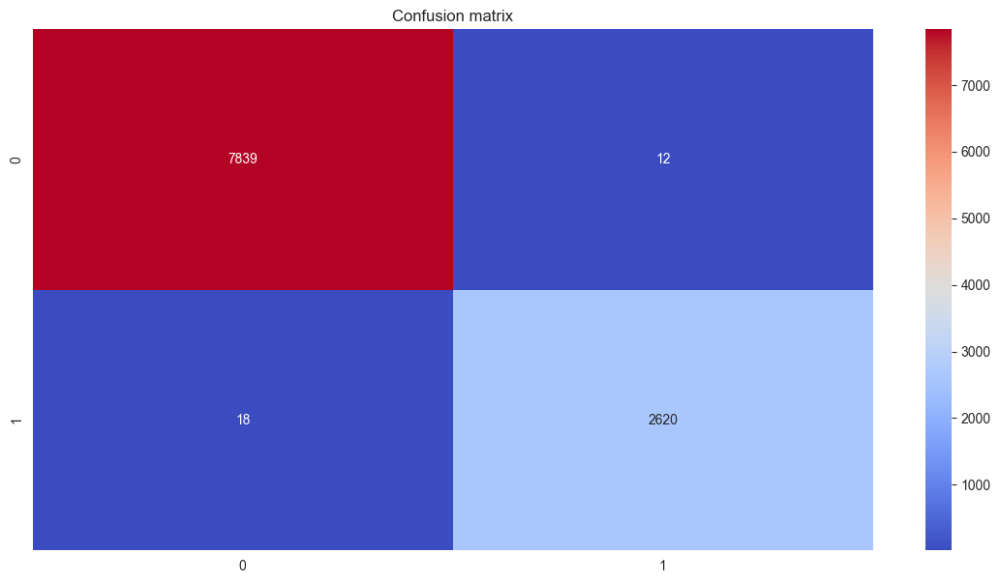

In [59]:
mplt.figure(figsize=(14, 7))
mplt.title("Confusion matrix")
sns.heatmap(confusion_matrix(y_test, y_pred_dt_gs), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

Výsledek se zlepšil pro falešně negativní třídy, ale zhoršil se pro falešně pozitivní třídy. Výsledek je tedy opravdu mírně lepší než u původního modelu, přesněji o jednu tisícinu.

In [60]:
best_dt_results = {
    'accuracy': accuracy_score(y_test, y_pred_dt_gs),
    'precision': precision_score(y_test, y_pred_dt_gs),
    'recall': recall_score(y_test, y_pred_dt_gs),
    'f1': f1_score(y_test, y_pred_dt_gs)
}

## RandomForest klasifikátor

Pro další krok zkusíme **RandomForest** klasifikátor, který je robustnější než DecisionTree a může dosáhnout lepších výsledků. Použijeme *SMOTE* pro vyvážení tříd a *GridSearchCV* pro hledání nejlepších parametrů pro model jelikož víme, že *RandomForest* dopadne lépe na vyvážených datech a *RandomForest* má býti robustnější než *DecisionTree*.

In [61]:
rf = RandomForestClassifier(random_state=42)

In [62]:
rf_param_grid = {
    'n_estimators': [50, 100, 200],
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 4, 8],
    'max_features': ['sqrt', 'log2'],
}

In [63]:
grid_search_rf = GridSearchCV(estimator=rf, param_grid=rf_param_grid, cv=5, n_jobs=-1, verbose=2)

In [64]:
with TimeTracker():
    grid_search_rf.fit(X_train_resampled, y_train_resampled)

Fitting 5 folds for each of 324 candidates, totalling 1620 fits
Celkový čas: 26 minut a 1.01 sekund


#### Nejlepší parametry pro RandomForest

In [65]:
grid_search_rf.best_params_

{'criterion': 'gini',
 'max_depth': None,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 5,
 'n_estimators': 200}

Toto jsou nejlepší parametry pro RandomForest.
- `N_estimators` je *200*, což znamená, že model použil 200 stromů pro predikci. Hodnota 200 je dostatečná pro dosažení dobrých výsledků, ale zde byla jako největší hodnota a strom by mohl čerpat i z většího počtu stromů za cenu výpočetního výkonu.
- `Criterion` je *gini*, což je stejná úvaha jako u DecisionTree.
- `Max_depth` je *None*, což je stejná úvaha jako u DecisionTree.
- `Min_samples_split` je *5*, což ukazuje na to, že model se dělil, pokud měl alespoň 5 vzorků ve svém uzlu. Zde je vidět, že model byl více opatrný na dělení než u DecisionTree. 
- `Min_samples_leaf` je *1*, což je stejná úvaha jako u DecisionTree.
- `Max_features` je *sqrt*, což znamená, že model použil odmocninu z počtu atributů pro rozhodování. Pdobnou úvahu jsme očekávali i u DecisionTree, až zde se provila.

In [66]:
y_pred_rf = grid_search_rf.predict(X_test)

In [67]:
print(classification_report(y_test, y_pred_rf))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99      7851
           1       0.97      0.98      0.98      2638

    accuracy                           0.99     10489
   macro avg       0.98      0.99      0.98     10489
weighted avg       0.99      0.99      0.99     10489



In [68]:
print(f"F1-score: {f1_score(y_test, y_pred_rf)}")

F1-score: 0.9770244821092279


In [69]:
best_rf_results = {
    'accuracy': accuracy_score(y_test, y_pred_rf),
    'precision': precision_score(y_test, y_pred_rf),
    'recall': recall_score(y_test, y_pred_rf),
    'f1': f1_score(y_test, y_pred_rf)
}

### Confusion matrix pro RandomForest

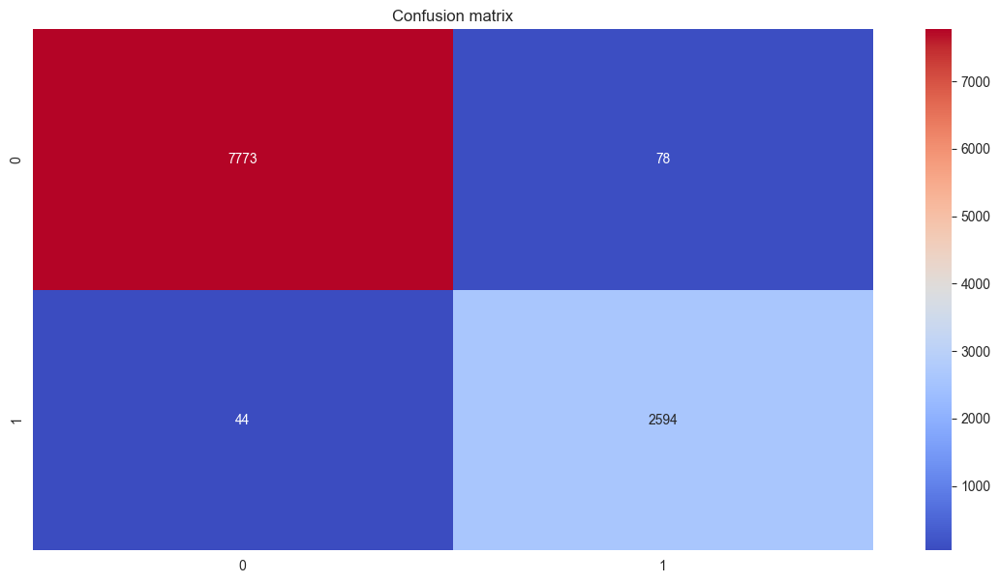

In [70]:
mplt.figure(figsize=(14, 7))
mplt.title("Confusion matrix")
sns.heatmap(confusion_matrix(y_test, y_pred_rf), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

Opět vidíme, že model predikoval většinu tříd drtivě správně. Zbytek povídání a porovnání výsledků si necháme na závěr.

## Gradient Boosting

### Gradient Boosting klasifikátor bez vyvážení tříd

In [71]:
gb = GradientBoostingClassifier(random_state=42)

In [72]:
gb.fit(X_train, y_train)

GradientBoostingClassifier(random_state=42)

In [73]:
y_pred_gb = gb.predict(X_test)

In [74]:
print(classification_report(y_test, y_pred_gb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7851
           1       0.99      0.99      0.99      2638

    accuracy                           1.00     10489
   macro avg       0.99      0.99      0.99     10489
weighted avg       1.00      1.00      1.00     10489



In [75]:
print(f"F1-score: {f1_score(y_test, y_pred_gb)}")

F1-score: 0.9901365705614568


#### Confusion matrix pro Gradient Boosting bez vyvážení tříd

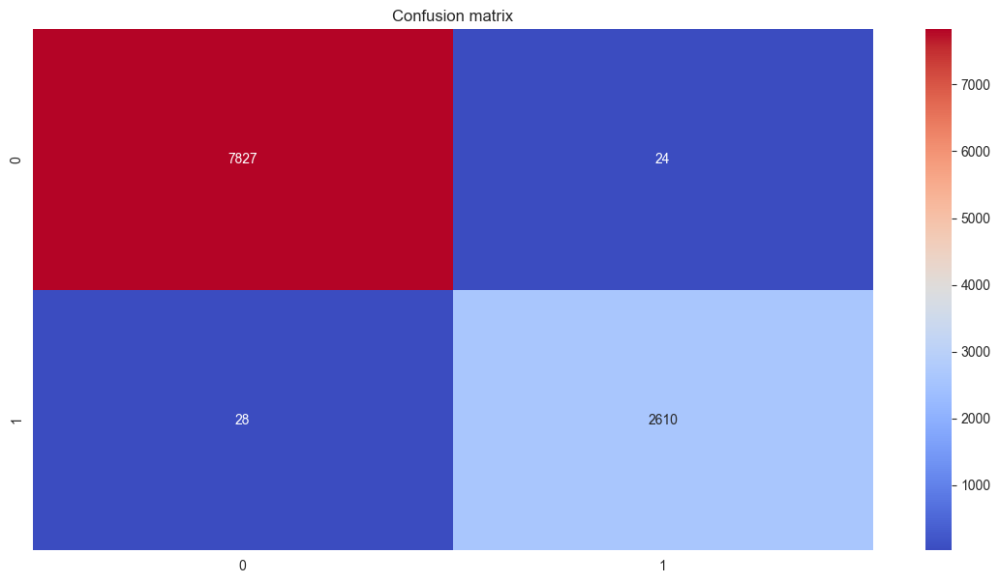

In [76]:
mplt.figure(figsize=(14, 7))
mplt.title("Confusion matrix")
sns.heatmap(confusion_matrix(y_test, y_pred_gb), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

### Gradient Boosting klasifikátor s vyváženými třídami

In [77]:
gb_resampled = GradientBoostingClassifier(random_state=42)

In [78]:
gb_resampled.fit(X_train_resampled, y_train_resampled)

GradientBoostingClassifier(random_state=42)

In [79]:
y_pred_gb_resampled = gb_resampled.predict(X_test)

In [80]:
print(classification_report(y_test, y_pred_gb_resampled))

              precision    recall  f1-score   support

           0       1.00      0.99      0.99      7851
           1       0.97      0.99      0.98      2638

    accuracy                           0.99     10489
   macro avg       0.98      0.99      0.99     10489
weighted avg       0.99      0.99      0.99     10489



In [81]:
print(f"F1-score: {f1_score(y_test, y_pred_gb_resampled)}")

F1-score: 0.9829556096647313


#### Confusion matrix pro Gradient Boosting s vyváženými třídami

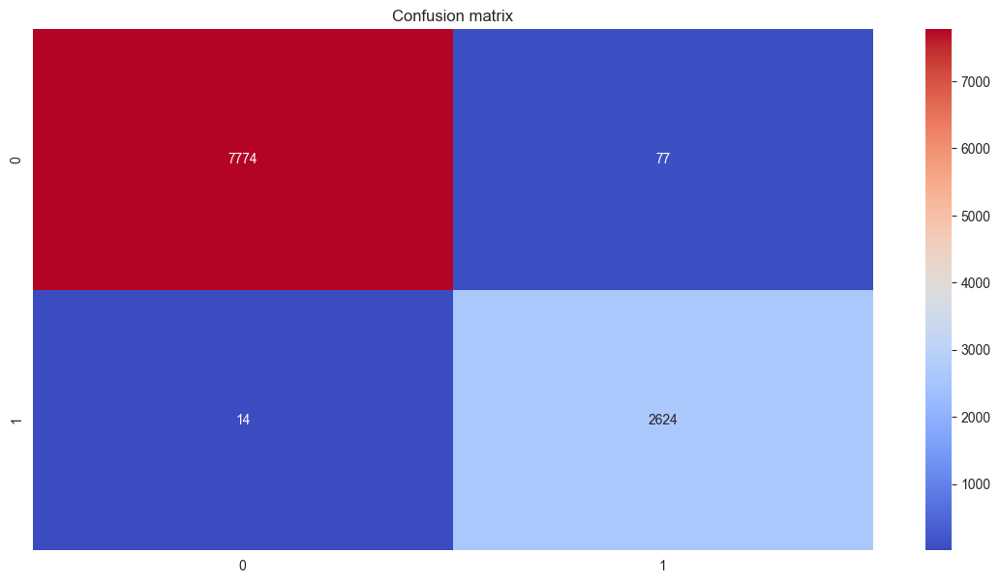

In [82]:
mplt.figure(figsize=(14, 7))
mplt.title("Confusion matrix")
sns.heatmap(confusion_matrix(y_test, y_pred_gb_resampled), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

In [83]:
no_smote_results_gb = {
    'accuracy': accuracy_score(y_test, y_pred_gb),
    'precision': precision_score(y_test, y_pred_gb),
    'recall': recall_score(y_test, y_pred_gb),
    'f1': f1_score(y_test, y_pred_gb)
}

smote_results_gb = {
    'accuracy': accuracy_score(y_test, y_pred_gb_resampled),
    'precision': precision_score(y_test, y_pred_gb_resampled),
    'recall': recall_score(y_test, y_pred_gb_resampled),
    'f1': f1_score(y_test, y_pred_gb_resampled)
}

In [84]:
for key in no_smote_results_gb.keys():
    print(f"{key}: {smote_results_gb[key]} - {no_smote_results_gb[key]} ="
          f" {smote_results_gb[key] - no_smote_results_gb[key]}")

accuracy: 0.9913242444465631 - 0.995042425398036 = -0.003718180951472916
precision: 0.9714920399851906 - 0.9908883826879271 = -0.01939634270273649
recall: 0.9946929492039424 - 0.9893858984078847 = 0.005307050796057644
f1: 0.9829556096647313 - 0.9901365705614568 = -0.007180960896725486


Zde se liší výsledky od metriky k metrice, ale opět to je tak zanedbatelné, že můžeme použíy oba dva. Pro zjednoduešní, porovnání s ostatními a i fakt, že F1 skóre dopadlo lépe pro model s vyváženými daty, tak použijeme ten.

### GridSearchCV pro Gradient Boosting

In [85]:
gb_param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 1],
    'max_depth': [3, 5, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

In [86]:
grid_search_gb = GridSearchCV(estimator=gb_resampled, param_grid=gb_param_grid, cv=5, n_jobs=-1, verbose=2)

In [87]:
with TimeTracker():
    grid_search_gb.fit(X_train_resampled, y_train_resampled)

Fitting 5 folds for each of 243 candidates, totalling 1215 fits
Celkový čas: 58 minut a 36.40 sekund


#### Nejlepší parametry pro Gradient Boosting

In [88]:
grid_search_gb.best_params_

{'learning_rate': 0.1,
 'max_depth': 10,
 'min_samples_leaf': 2,
 'min_samples_split': 5,
 'n_estimators': 100}

Toto jsou nejlepší parametry pro Gradient Boosting.
- `N_estimators` je *200*, což je stejná úvaha jako u RandomForest. Model by benefitoval z většího počtu stromů, ale zde byla jako největší hodnota a strom by mohl čerpat i z většího počtu stromů za cenu výpočetního výkonu.
- `Learning_rate` je *0.1*, což znamená, že model se učí pomalu, ale jistě. Větší hodnota by znamenala rychlejší učení, ale mohla by přeskočit nejlepší hodnoty.
- `Max_depth` je *10*, což znamená, že model použil 10 stromy pro predikci. Tato hodnota je dostatečná pro dosažení dobrých výsledků, ale zde byla jako největší hodnota a strom by mohl čerpat i z většího počtu stromů za cenu výpočetního výkonu.
- `Min_samples_split` je *5*, což je stejná úvaha jako u DecisionTree.
- `Min_samples_leaf` je *2*, což je stejná úvaha jako u DecisionTree.

In [89]:
y_pred_gb_gs = grid_search_gb.predict(X_test)

In [90]:
print(classification_report(y_test, y_pred_gb_gs))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7851
           1       0.99      1.00      1.00      2638

    accuracy                           1.00     10489
   macro avg       1.00      1.00      1.00     10489
weighted avg       1.00      1.00      1.00     10489



In [91]:
print(f"F1-score: {f1_score(y_test, y_pred_gb_gs)}")

F1-score: 0.9954562665656949


#### Confusion matrix pro Gradient Boosting s nejlepšími parametry

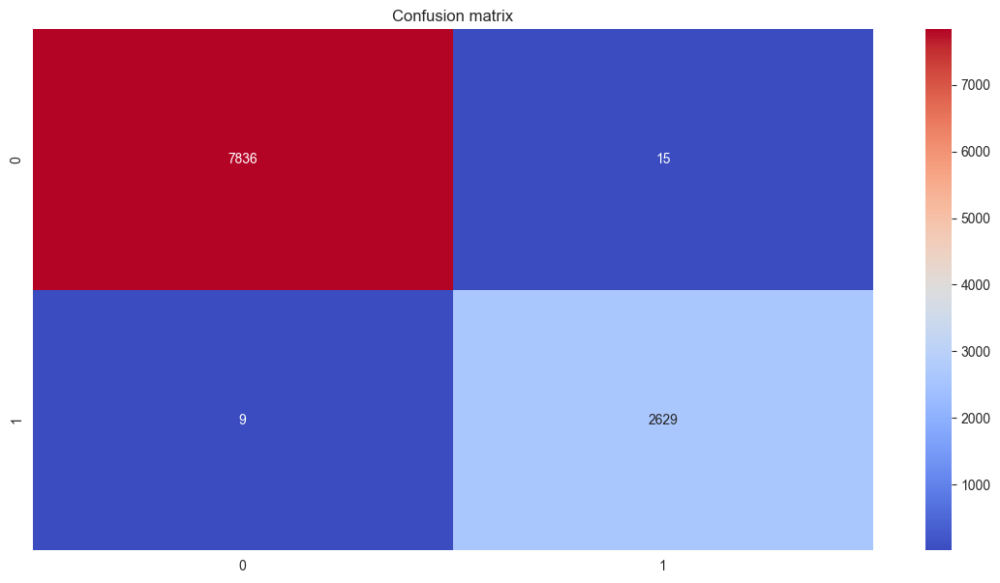

In [92]:
mplt.figure(figsize=(14, 7))
mplt.title("Confusion matrix")
sns.heatmap(confusion_matrix(y_test, y_pred_gb_gs), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

## Logistická regrese

### Logistická regrese bez vyvážení tříd

In [93]:
lr = LogisticRegression(random_state=42, max_iter=1_000)

In [94]:
with warnings.catch_warnings(record=True) as w:
    warnings.simplefilter("always")
    lr.fit(X_train, y_train)
    for i in w:
        print(i.message)

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Logistická regrese je jednoduchý lineární klasifikátor, který se snaží najít nejlepší lineární rovinu pro rozdělení tříd. Potřebuje oproti rozhodovacím stromům a Random Forestu škálovaná data, což musíme provést. Buď to, nebo navýšit počet iterací, což může způsobit, že model bude trvat déle, což je zbytečný trade-off. 

Jelikož jsme si ukázaly, že škálování dat nemá vliv v našem datasetu skoro žádný efekt, tak můžeme použít `StandardScaler` pro škálování dat.

In [95]:
lr = make_pipeline(StandardScaler(), LogisticRegression(random_state=42, max_iter=1_000))

In [96]:
lr.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('logisticregression',
                 LogisticRegression(max_iter=1000, random_state=42))])

In [97]:
y_pred_lr = lr.predict(X_test)

In [98]:
print(classification_report(y_test, y_pred_lr))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7851
           1       1.00      0.99      1.00      2638

    accuracy                           1.00     10489
   macro avg       1.00      1.00      1.00     10489
weighted avg       1.00      1.00      1.00     10489



In [99]:
print(f"F1-score: {f1_score(y_test, y_pred_lr)}")

F1-score: 0.9967686751568143


To už je lepší. Model dosáhl **F1-skóre 0,9967**, což je velmi dobrý výsledek. Všechny třídy byly predikovány správně. Podívejme se na **confusion matrix**, abychom zjistili, zda model se nanaučil predikovat pouze největší třídu.

#### Confusion matrix pro Logistickou regresi bez vyvážení tříd

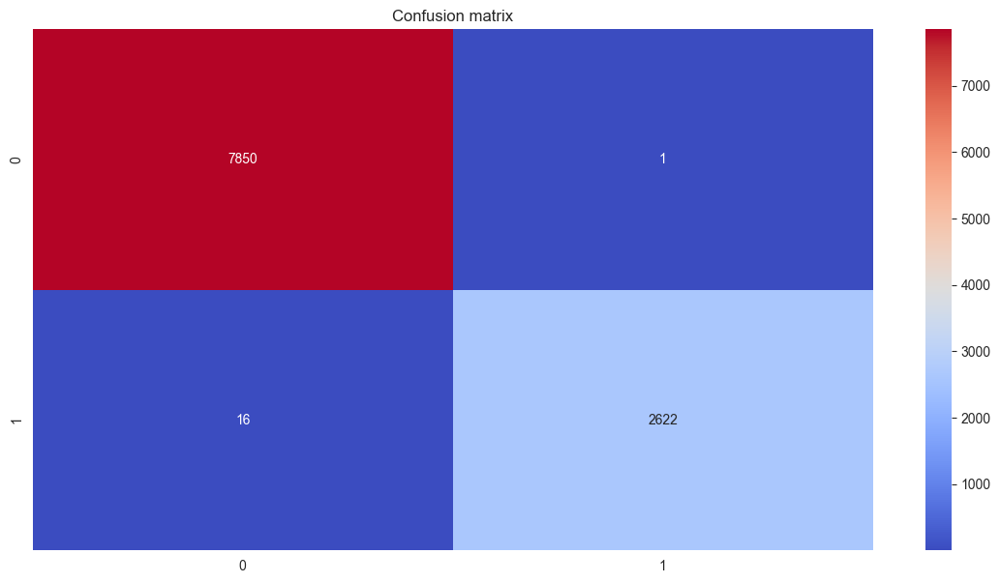

In [100]:
mplt.figure(figsize=(14, 7))
mplt.title("Confusion matrix")
sns.heatmap(confusion_matrix(y_test, y_pred_lr), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

### Logistická regrese s vyváženými třídami    

In [101]:
lr_resampled = make_pipeline(StandardScaler(), LogisticRegression(random_state=42, max_iter=1_000))

In [102]:
lr_resampled.fit(X_train_resampled, y_train_resampled)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('logisticregression',
                 LogisticRegression(max_iter=1000, random_state=42))])

In [103]:
y_pred_lr_resampled = lr_resampled.predict(X_test)

In [104]:
print(classification_report(y_test, y_pred_lr_resampled))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7851
           1       1.00      0.99      1.00      2638

    accuracy                           1.00     10489
   macro avg       1.00      1.00      1.00     10489
weighted avg       1.00      1.00      1.00     10489



In [105]:
print(f"F1-score: {f1_score(y_test, y_pred_lr_resampled)}")

F1-score: 0.9965792474344356


Obdobně úžasně vysoké skóre jako u modelu bez vyvážení tříd. Podívejme se na **confusion matrix**, jestli se něco změnilo.

#### Confusion matrix pro Logistickou regresi s vyváženými třídami

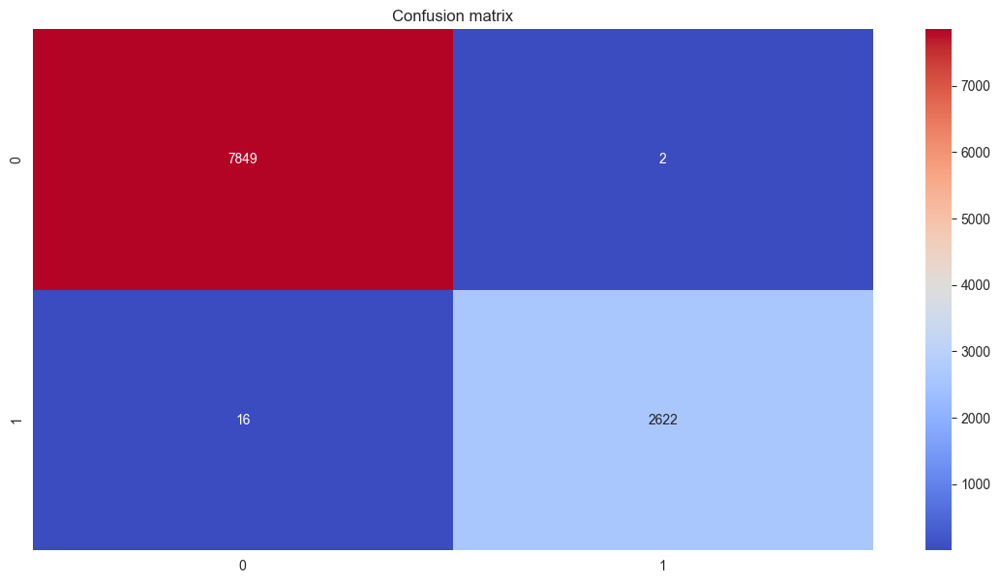

In [106]:
mplt.figure(figsize=(14, 7))
mplt.title("Confusion matrix")
sns.heatmap(confusion_matrix(y_test, y_pred_lr_resampled), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

In [107]:
no_smote_results_lr = {
    'accuracy': accuracy_score(y_test, y_pred_lr),
    'precision': precision_score(y_test, y_pred_lr),
    'recall': recall_score(y_test, y_pred_lr),
    'f1': f1_score(y_test, y_pred_lr)
}

smote_results_lr = {
    'accuracy': accuracy_score(y_test, y_pred_lr_resampled),
    'precision': precision_score(y_test, y_pred_lr_resampled),
    'recall': recall_score(y_test, y_pred_lr_resampled),
    'f1': f1_score(y_test, y_pred_lr_resampled)
}

In [108]:
for key in no_smote_results_lr.keys():
    print(f"{key}: {smote_results_lr[key]} - {no_smote_results_lr[key]} ="
          f" {smote_results_lr[key] - no_smote_results_lr[key]}")

accuracy: 0.9982839164839356 - 0.9983792544570502 = -9.533797311467307e-05
precision: 0.9992378048780488 - 0.9996187571483035 = -0.00038095227025469747
recall: 0.9939347990902199 - 0.9939347990902199 = 0.0
f1: 0.9965792474344356 - 0.9967686751568143 = -0.00018942772237873218


Rozdíl je opravdu zanedbatelný, ale pro další bádání použijeme model s vyváženými daty. 

### GridSearchCV pro Logistickou regresi

In [123]:
lr_param_grid = {
    'logisticregression__penalty': ['l1', 'l2', 'elasticnet', 'none'],
    'logisticregression__C': [0.001, 0.01, 0.1, 1, 10, 100],
    'logisticregression__solver': ['lbfgs', 'liblinear', 'saga'],
    'logisticregression__max_iter': [500, 1_000, 10_000]
}

In [124]:
grid_search_lr = GridSearchCV(estimator=lr_resampled, param_grid=lr_param_grid, cv=5, n_jobs=-1, verbose=2)

In [125]:
with TimeTracker():
    with warnings.catch_warnings(record=True) as w:
        warnings.simplefilter("always")
        grid_search_lr.fit(X_train_resampled, y_train_resampled)

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Celkový čas: 11 minut a 41.21 sekund


Zde zachycujeme `ConvergenceWarning`, který nám říká, že model nedosáhl konvergence. To znamená, že model nedosáhl optimálního řešení, ale zastavil se předem. To může být způsobeno tím, že model nemá dostatečně velký počet iterací, nebo že model nemá dostatečně velký počet vzorků pro učení. V našem případě to je pravděpodobně způsobeno nemá dostatečně velký počet iterací. Máme velký počet dat a model by mohl potřebovat více iterací pro dosažení optimálního řešení. To je ale zbytečný trade-off, protože model už dosáhl velmi dobrých výsledků.

In [126]:
grid_search_lr.best_params_

{'logisticregression__C': 100,
 'logisticregression__max_iter': 10000,
 'logisticregression__penalty': 'l1',
 'logisticregression__solver': 'saga'}

Tyto parametry byly vybrány jako nejlepší.
- `Penalty` je *l1*, což je způsob regularizace, který zabraňuje modelu v přeučení. Hlavní rozdíl mezi *l1* a *l2* je v tom, že *l1* může zredukovat některé atributy na nulu, což znamená, že model se může naučit ignorovat některé atributy.
- `C` je *100*, což je hodnota regularizačního parametru. Čím je hodnota vyšší, tím více se model bude snažit přizpůsobit datům, což může způsobit přeučení. Zde je hodnota nejvyšší, což znamená, že model se snažil co nejvíce přizpůsobit datům a ignorovat regularizaci.
- `Solver` je *saga*, což je algoritmus pro optimalizaci, který je vhodný pro velké datasety oproti *lbfgs* a *liblinear*, které jsou vhodné pro malé datasety.
- `Max_iter` je *10_000*, což je počet iterací, které model provedl. Je to nejvyšší hodnota, což znamená, že model mohl dosáhnout optimálního řešení a benefitoval by z většího počtu iterací.

In [127]:
y_pred_lr_gs = grid_search_lr.predict(X_test)

In [128]:
print(classification_report(y_test, y_pred_lr_gs))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7851
           1       1.00      1.00      1.00      2638

    accuracy                           1.00     10489
   macro avg       1.00      1.00      1.00     10489
weighted avg       1.00      1.00      1.00     10489



In [129]:
print(f"F1-score: {f1_score(y_test, y_pred_lr_gs)}")

F1-score: 0.9994310639104874


#### Confusion matrix pro Logistickou regresi s nejlepšími parametry

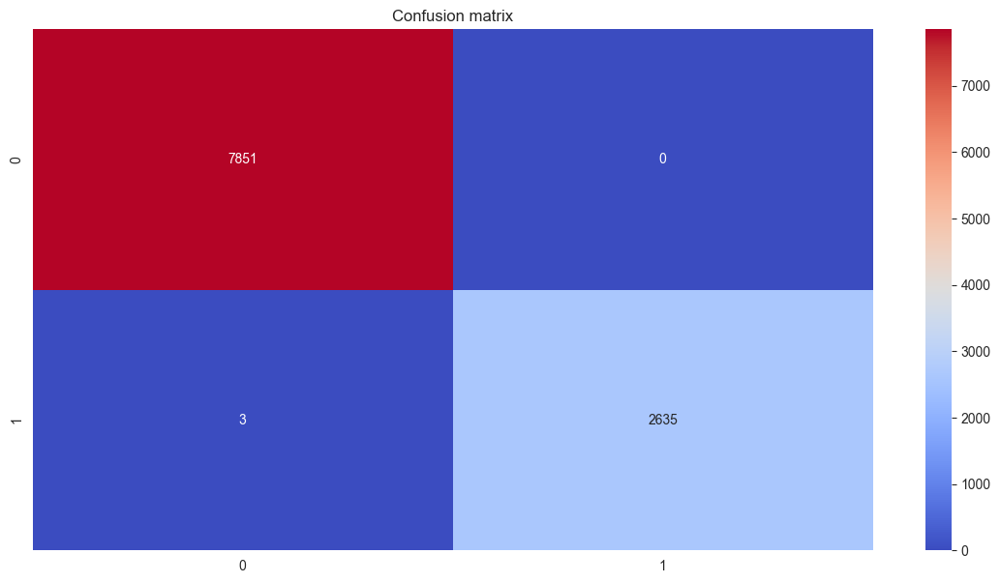

In [130]:
mplt.figure(figsize=(14, 7))
mplt.title("Confusion matrix")
sns.heatmap(confusion_matrix(y_test, y_pred_lr_gs), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

In [131]:
best_lr_results = {
    'accuracy': accuracy_score(y_test, y_pred_lr_gs),
    'precision': precision_score(y_test, y_pred_lr_gs),
    'recall': recall_score(y_test, y_pred_lr_gs),
    'f1': f1_score(y_test, y_pred_lr_gs)
}

# Závěr

In [132]:
results = pd.DataFrame({
    'DecisionTree': best_dt_results,
    'RandomForest': best_rf_results,
    'GradientBoosting': smote_results_gb,
    'LogisticRegression': best_lr_results
})

In [133]:
results

,DecisionTree,RandomForest,GradientBoosting,LogisticRegression
accuracy,0.997140,0.988369,0.991324,0.999714
precision,0.995441,0.970808,0.971492,1.000000
recall,0.993177,0.983321,0.994693,0.998863
f1,0.994307,0.977024,0.982956,0.999431


Porovnání výsledků 🏆
1. Accuracy (Přesnost) ✅

    **LogisticRegression** vede s **0.9997** a dosahuje nejlepší přesnosti, což znamená, že model velmi efektivně predikuje třídy a minimalizuje chyby. 🎯
    **DecisionTree** 🌳 (0.9971) a **GradientBoosting** 🚀 (0.9913) mají také vysokou přesnost, ale lehce zaostávají za LogisticRegression.
    **RandomForest** 🌲 (0.9884) vykazuje nižší přesnost než ostatní modely, což může znamenat, že má občas problémy s některými specifickými datovými případy. 📉

2. Precision (Preciznost) 🎯

    **LogisticRegression** zůstává bezkonkurenční s precizností **1.0000**, což znamená, že model minimalizuje falešné pozitivní predikce. 💎
    **DecisionTree** (0.9954) a GradientBoosting (0.9715) mají nižší preciznost, ale stále jsou na velmi dobré úrovni.
    **RandomForest** (0.9708) vykazuje nejnižší hodnotu v preciznosti, což naznačuje vyšší výskyt falešně pozitivních predikcí. ⚠️

3. Recall (Citlivost) 👀

    **GradientBoosting** (0.9947) dosahuje nejlepší hodnoty recall, což znamená, že velmi dobře zachycuje pozitivní případy a minimalizuje falešné negativy. 👍
    **LogisticRegression** (0.9989) se mu velmi přibližuje a rovněž vykazuje vysokou citlivost.
    **DecisionTree** (0.9932) a **RandomForest** (0.9833) mají nižší recall, což znamená, že občas mohou ztratit některé pozitivní případy. 😟

4. F1 Score (Vyváženost mezi Precizností a Recall) ⚖️

    **LogisticRegression** vede i v této kategorii s F1 skóre **0.9994**, což naznačuje nejlepší rovnováhu mezi precizností a citlivostí. 🏅
    **DecisionTree** (0.9943) vykazuje velmi dobrý výsledek, ale stále o něco horší než LogisticRegression.
    **RandomForest** (0.9770) a GradientBoosting (0.9830) mají nižší F1 skóre, což naznačuje menší rovnováhu mezi precizností a recall. 🔄

Výběr modelu 🏅

Na základě výsledků je LogisticRegression jasným vítězem pro tento úkol! 🎉 Dosahuje skvělých výsledků napříč všemi metrikami, včetně přesnosti, preciznosti, citlivosti a F1 skóre. Tento model je ideální volbou pro úkoly, kde je důležitá přesnost klasifikace a minimalizování jak falešně pozitivních, tak falešně negativních predikcí. Sice vyžadoval předzpracování dat, ale výsledek to stál. 👏

DecisionTree 🌳 a GradientBoosting 🚀 jsou silné modely s podobnými výsledky v přesnosti a F1 skóre, ale s nižšími hodnotami v preciznosti a recall. Pokud je pro vás důležitá vyšší schopnost zachytit pozitivní případy (recall), GradientBoosting bude výborná volba. 💪

RandomForest 🌲 vykazuje nižší výkon napříč všemi metrikami, ale stále je to velmi robustní model, který může mít své místo v případech, kdy je potřeba stabilita a schopnost pracovat s různými datovými typy.

Celkově je LogisticRegression vítězem 🏆 díky své vysoké přesnosti a vyváženému výkonu v citlivosti i preciznosti.

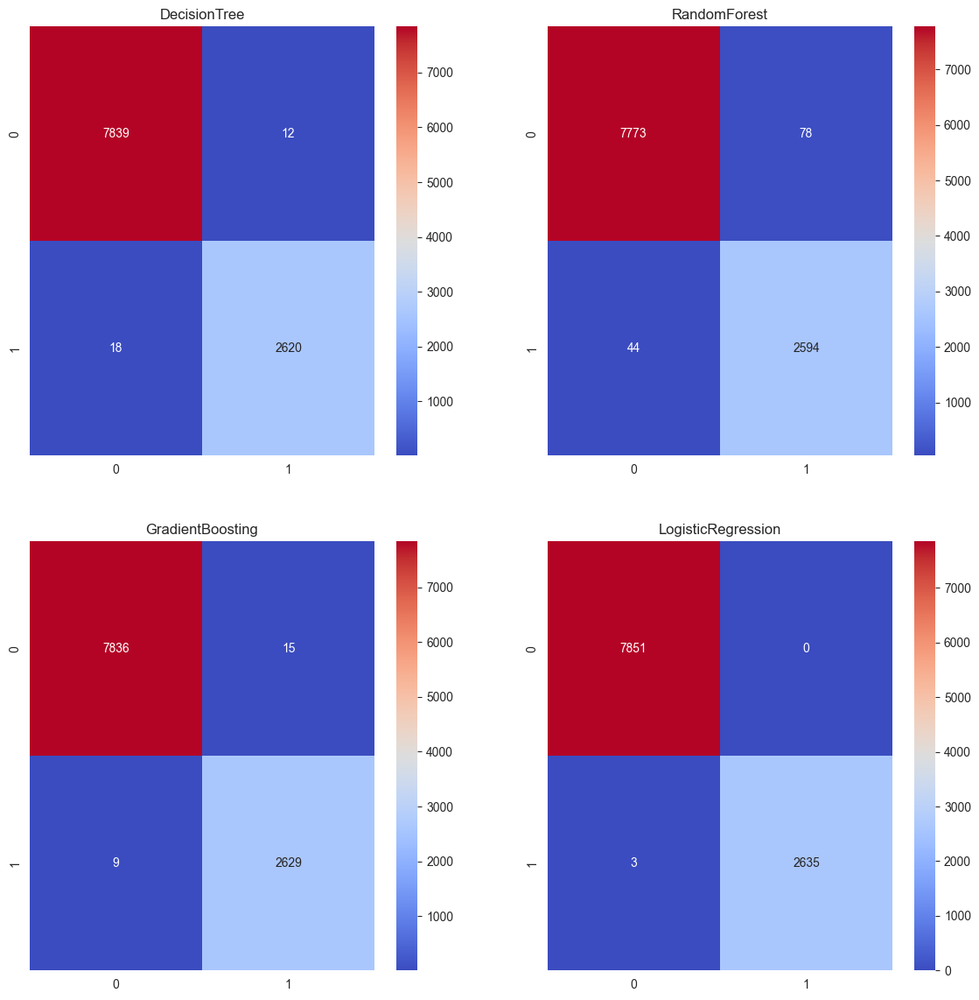

In [134]:
mplt.figure(figsize=(14, 14))
mplt.subplot(2, 2, 1)
mplt.title("DecisionTree")
sns.heatmap(confusion_matrix(y_test, y_pred_dt_gs), annot=True, fmt="d", cmap='coolwarm')
mplt.subplot(2, 2, 2)
mplt.title("RandomForest")
sns.heatmap(confusion_matrix(y_test, y_pred_rf), annot=True, fmt="d", cmap='coolwarm')
mplt.subplot(2, 2, 3)
mplt.title("GradientBoosting")
sns.heatmap(confusion_matrix(y_test, y_pred_gb_gs), annot=True, fmt="d", cmap='coolwarm')
mplt.subplot(2, 2, 4)
mplt.title("LogisticRegression")
sns.heatmap(confusion_matrix(y_test, y_pred_lr_gs), annot=True, fmt="d", cmap='coolwarm')
mplt.show()

Z confusin matrix můžeme vidět, že všechny modely predikovaly většinu velmi úspěšně. **LogisticRegression** udělalo jen 3 chyby, což je neuvěřitelné, tento algoritmus vyžadoval nejvíce práce na předzpracování dat, ale výsledek to stál. 